<a href="https://colab.research.google.com/github/EstherMatamoros/InterfaceAnalysis/blob/master/Nuclei_and_Clusters_Analysis_(Clean).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Nuclei and Cluster Analysis**

This code aims to count the single nuclei and identify clusters based on size, proximity, and shape.

It handles special cases where intensity is low and additional preprocessing is applied.

The Count is divided into single nuclei and Clusters per different substrate topologies (Diameter and Pitch of pillars) and by protein expressed (Actin and Pax).

The visualization of results allows us to visually inspect the cluster and nuclei identification per image, and also compare the counts per substrate topology and protein expression.

# Imports

In [1]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import DBSCAN
from scipy.spatial import ConvexHull
from scipy.spatial import KDTree
from sklearn.preprocessing import StandardScaler
import re
from statsmodels.formula.api import ols
import statsmodels.api as sm

# Image preprocessing

In [2]:
def stretch_contrast(image):
    """
    Stretch the contrast of an image to span the full 0-255 intensity range.

    Parameters:
    - image: A numpy array representing the input image.

    Returns:
    - A numpy array of the image with stretched contrast.
    """
    img_float = image.astype(np.float64)
    min_intensity = np.min(img_float)
    max_intensity = np.max(img_float)
    stretched_img = 255 * (img_float - min_intensity) / (max_intensity - min_intensity)
    return stretched_img.astype(np.uint8)

def additional_preprocessing(stretched_image, threshold=5, kernel_size=(3, 3)):
    """
    Apply additional preprocessing to enhance features in a stretched image.

    Parameters:
    - stretched_image: The image to process.
    - threshold: Intensity threshold for binary thresholding.
    - kernel_size: Size of the kernel for morphological operations.

    Returns:
    - A numpy array of the processed image.
    """
    gradient_x = cv2.Sobel(stretched_image, cv2.CV_64F, 1, 0, ksize=3)
    gradient_y = cv2.Sobel(stretched_image, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(gradient_x**2 + gradient_y**2)
    binary_image = cv2.threshold(stretched_image, threshold, 255, cv2.THRESH_BINARY)[1]
    peak_mask = cv2.bitwise_and(binary_image, (gradient_magnitude > threshold).astype(np.uint8) * 255)
    kernel = np.ones(kernel_size, np.uint8)
    peak_mask = cv2.morphologyEx(peak_mask, cv2.MORPH_CLOSE, kernel)
    eroded = cv2.erode(peak_mask, kernel, iterations=2)
    dilated = cv2.dilate(eroded, kernel, iterations=1)
    return dilated.astype(np.uint8)

def load_and_preprocess_image(image_path, kernel, gaussian_blur_size=(9, 9), erode_iter=10, dilate_iter=2, offset=20):
    """
    Load an image, apply Gaussian blur, stretch contrast, and perform binary thresholding followed by morphological operations.

    Parameters:
    - image_path: Path to the image file.
    - kernel: Kernel for morphological operations.
    - gaussian_blur_size: Size of the kernel for Gaussian blur.
    - erode_iter: Number of iterations for erosion.
    - dilate_iter: Number of iterations for dilation.
    - offset : Offset for thresholding

    Returns:
    - Tuple of stretched image and final processed image.
    """
    gray_image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    blurred_image = cv2.GaussianBlur(gray_image, (9, 9), 0)
    stretched_image = stretch_contrast(blurred_image)
    _, preliminary_threshold = cv2.threshold(stretched_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    final_threshold = int(preliminary_threshold[0][0] + offset)
    _, binary_image = cv2.threshold(stretched_image, final_threshold, 255, cv2.THRESH_BINARY)

    if np.sum(binary_image) == 0:  # Check if the binary mask is completely black
        # Calculate gradient magnitude using the Sobel operator
        binary_image = additional_preprocessing(stretched_image)

    eroded = cv2.erode(binary_image, kernel, iterations=10)
    dilated = cv2.dilate(eroded, kernel, iterations=2)
    dilated = dilated.astype(np.uint8)
    return stretched_image, dilated


# Cluster analysis

In [3]:
def find_and_process_contours(binary_image, min_nucleus_area, scale_factor, solidity_threshold=0.8, eps=50, min_samples=5):
    """
    Identify and categorize contours in a binary image into small contours (single nuclei) and clusters of nuclei.

    Parameters:
    - binary_image: Input binary image where nuclei are to be detected.
    - min_nucleus_area: Minimum area threshold to classify small vs. large contours.
    - scale_factor: Scaling factor to adjust min_nucleus_area based on image resolution.
    - solidity_threshold: Solidity threshold to filter out non-compact large contours.
    - eps: The maximum distance between two samples for them to be considered as in the same neighborhood (DBSCAN).
    - min_samples: The number of samples in a neighborhood for a point to be considered as a core point (DBSCAN).

    Returns:
    - small_contours: List of contours classified as small (single nuclei).
    - n_clusters: Number of identified clusters.
    - n_noise: Number of points classified as noise by DBSCAN.
    - points: Array of points used for DBSCAN clustering.
    - labels: DBSCAN labels for each point in `points`.
    """
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    small_contours = []
    large_filtered_contours = []

    # Split contours into small and large based on area, apply solidity filter to large ones
    for contour in contours:
        area = cv2.contourArea(contour)
        if area < min_nucleus_area * scale_factor:
            small_contours.append(contour)
        else:
            hull = cv2.convexHull(contour)
            hull_area = cv2.contourArea(hull)
            if hull_area > 0:  # Avoid division by zero
                solidity = area / hull_area
                if solidity > solidity_threshold:
                    large_filtered_contours.append(contour)

    # Check if there are any large_filtered_contours before proceeding
    if not large_filtered_contours:  # No large contours to process
        return small_contours, 0, 0, large_filtered_contours, []

    # Prepare for DBSCAN: Convert contours to points
    points = np.vstack([contour.squeeze() for contour in large_filtered_contours])

    # Run DBSCAN
    clustering = DBSCAN(eps=eps, min_samples=min_samples).fit(points)
    labels = clustering.labels_

    # Count clusters and noise
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise = list(labels).count(-1)

    # Return counts
    return small_contours, n_clusters, n_noise, large_filtered_contours, labels


# Plotting Image processing and Analysis results - Main

In [4]:
# Helper functions to sort the conditions numerically
def numerical_sort(condition):
    if condition == 'Flat':
      return (float('inf'), float('inf'))

    numbers = re.findall(r'\d+', condition)
    return tuple(int(x) for x in numbers)

def parse_folder_name(folder_name):
    # Regex to extract the diameter and pillar height from the folder name (e.g., "D2P12")
    match = re.search(r'D(\d+)P(\d+)', folder_name)
    if match:
        diameter = int(match.group(1))
        pitch = int(match.group(2))
    else:
        # Default values for folders without pillar information, e.g., "Nucleus Flat Si"
        diameter = 0
        pitch = 0
    return diameter, pitch

In [8]:
def analyze_folder(folder_path, kernel, min_nucleus_area, scale_factor, diameter, pitch, solidity_threshold=0.8, eps=50, min_samples=5, offset = 20, threshold = 5):
    """
    Analyzes a folder of .tif images to identify and classify nuclei based on given parameters.

    Parameters:
    - folder_path: Path to the folder containing images.
    - kernel: Morphological operation kernel.
    - min_nucleus_area: Minimum area to consider for a nucleus.
    - scale_factor: Scaling factor for image analysis.
    - diameter: Diameter of something (context-specific).
    - pitch: Pitch of something (context-specific).
    - solidity_threshold: Threshold for contour solidity to classify clusters.
    - eps: The maximum distance between two samples for them to be considered as in the same neighborhood (DBSCAN).
    - min_samples: The number of samples in a neighborhood for a point to be considered as a core point (DBSCAN).
    - offset : Offset for thresholding

    Returns:
    - A list of dictionaries containing analysis results for each image.
    """
    image_files = [f for f in os.listdir(folder_path) if f.endswith(".tif")]
    if not image_files:  # Early exit if no images found
        return []

    num_cols = 4
    num_rows = (len(image_files) + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 20))
    fig.suptitle(f"Analysis: {os.path.basename(folder_path)}", fontsize=16)

    data_list = []

    for i, filename in enumerate(image_files):
        image_path = os.path.join(folder_path, filename)
        stretched_image, processed_image = load_and_preprocess_image(image_path, kernel, gaussian_blur_size=(9, 9), erode_iter=10, dilate_iter=2, offset=20)
        small_contours, n_clusters, n_noise, large_filtered_contours, labels = find_and_process_contours(processed_image, min_nucleus_area, scale_factor, solidity_threshold, eps, min_samples)

        # Initialize images for drawing only if additional preprocessing will not occur
        total_clusters = n_clusters
        if total_clusters >= 5:
            image = cv2.imread(image_path)
            # Draw initial contours
            for contour in small_contours:
                cv2.drawContours(image, [contour], -1, (0, 255, 0), 2)
            for contour, label in zip(large_filtered_contours, labels):
                if label != -1:
                    cv2.drawContours(image, [contour], -1, (255, 0, 0), 2)

        else:
            # Additional preprocessing is applied directly to the original image for reanalysis
            image = cv2.imread(image_path)
            binary_image = additional_preprocessing(stretched_image, threshold=5, kernel_size=(3, 3))
            small_contours, n_clusters, n_noise, large_filtered_contours, labels = find_and_process_contours(binary_image, min_nucleus_area, scale_factor, solidity_threshold, eps, min_samples)
            # Draw contours after reprocessing
            for contour in small_contours:
                cv2.drawContours(image, [contour], -1, (0, 255, 0), 2)
            for contour, label in zip(large_filtered_contours, labels):
                if label != -1:
                    cv2.drawContours(image, [contour], -1, (255, 0, 0), 2)

        # Plot the final results
        row, col = divmod(i, num_cols)
        axes[row, col].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        axes[row, col].set_title(f"{i}\nTotal Particles: {len(small_contours) + n_clusters}\nSingle Nuclei: {len(small_contours)}\nClusters: {n_clusters}", fontsize=7)
        axes[row, col].axis('off')

        # Add the mask paths to the data list
        data_list.append({
            'Folder': os.path.dirname(image_path),
            'Image': os.path.basename(image_path),
            'Total Particles': len(small_contours) + total_clusters,
            'Clusters': total_clusters,
            'Single Nuclei': len(small_contours),
            'Diameter': diameter,
            'Pitch': pitch
        })

    return data_list


<ipython-input-8-bf6656995625>:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 20))


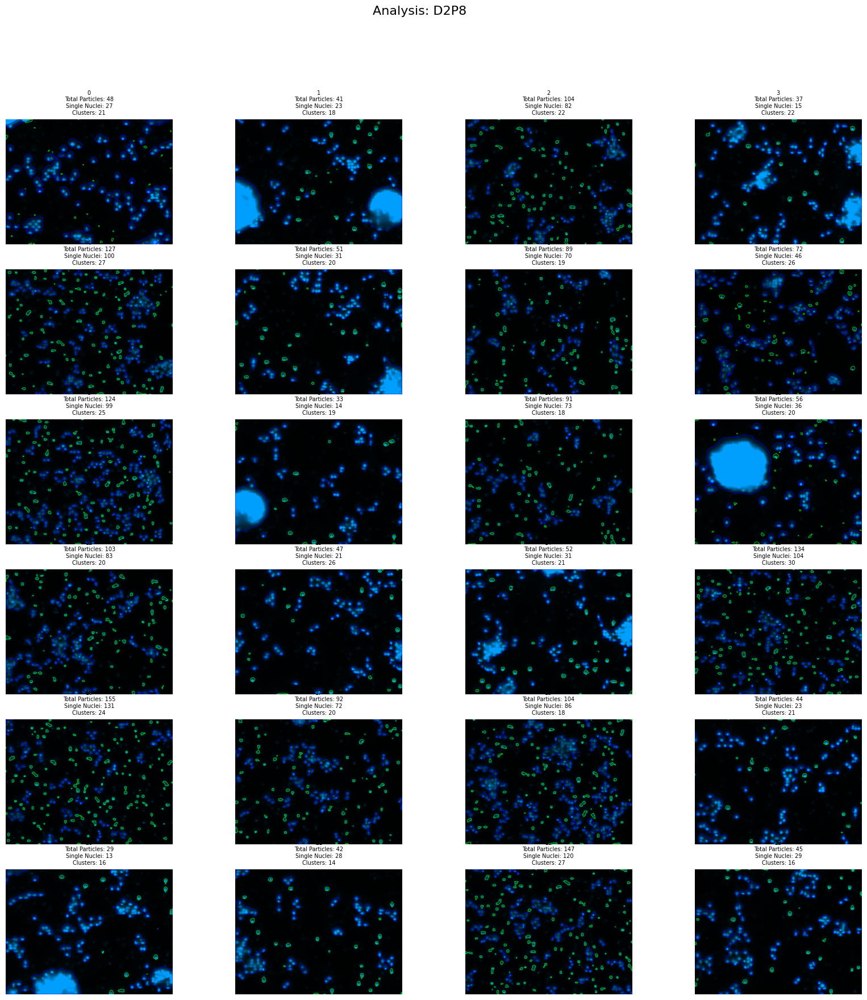

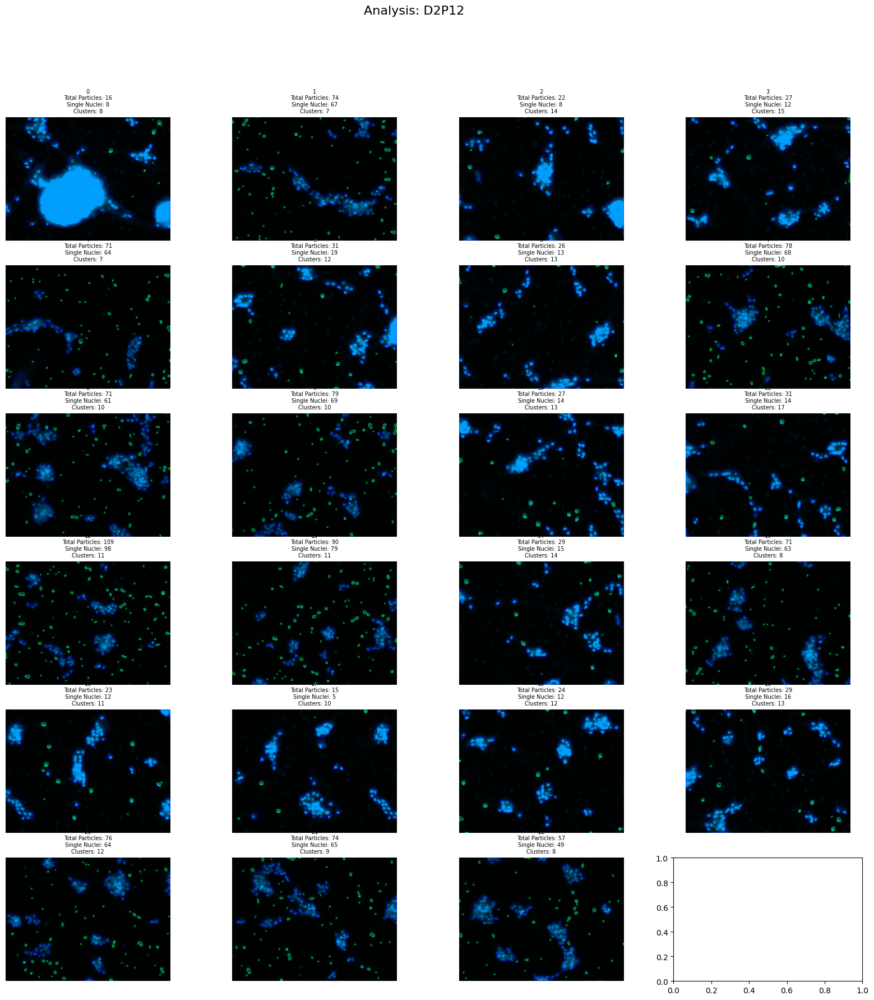

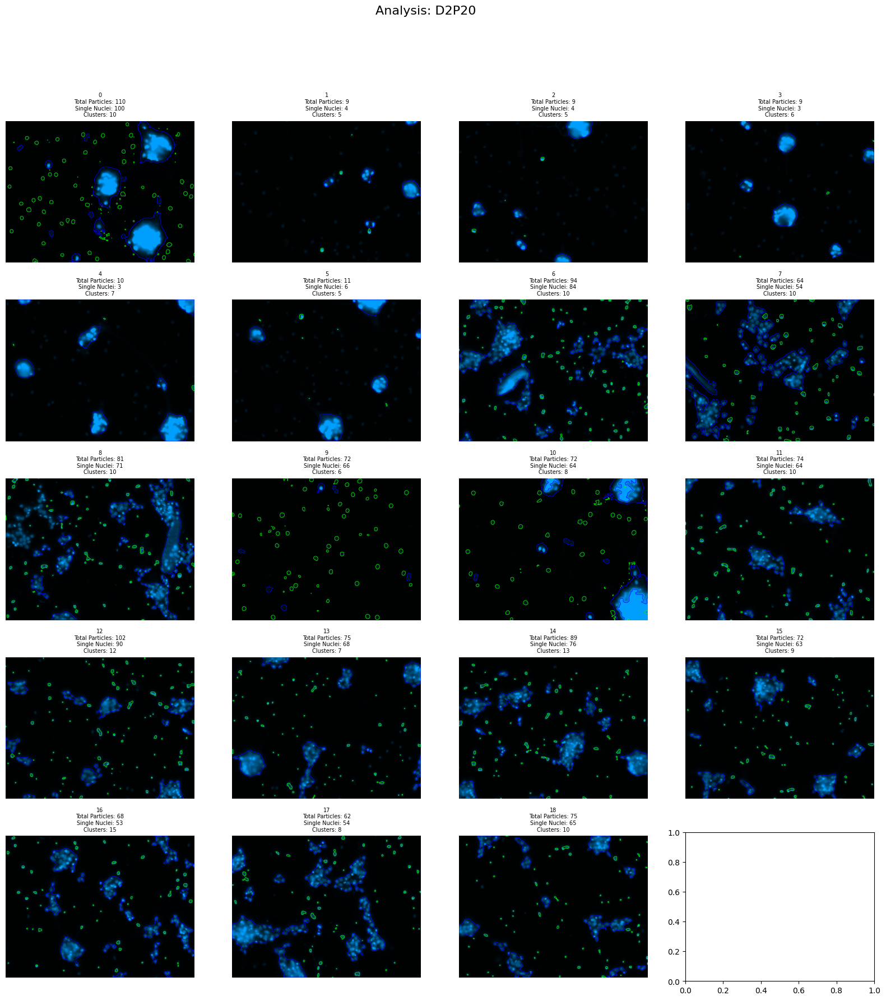

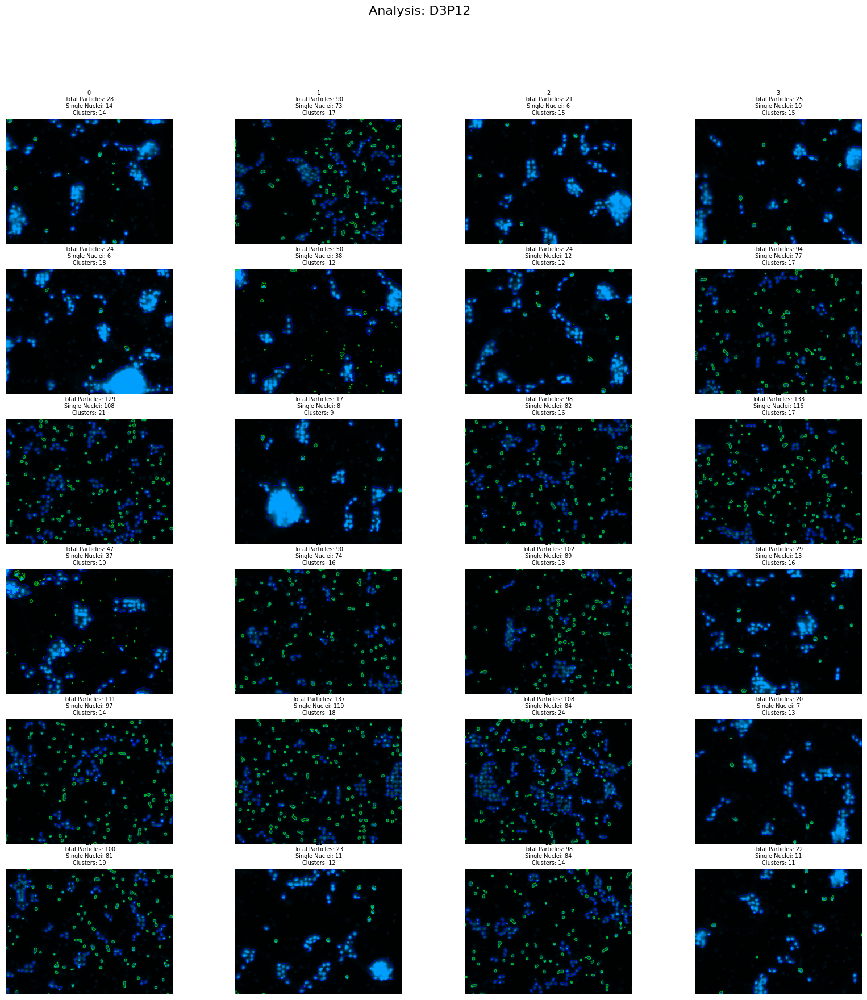

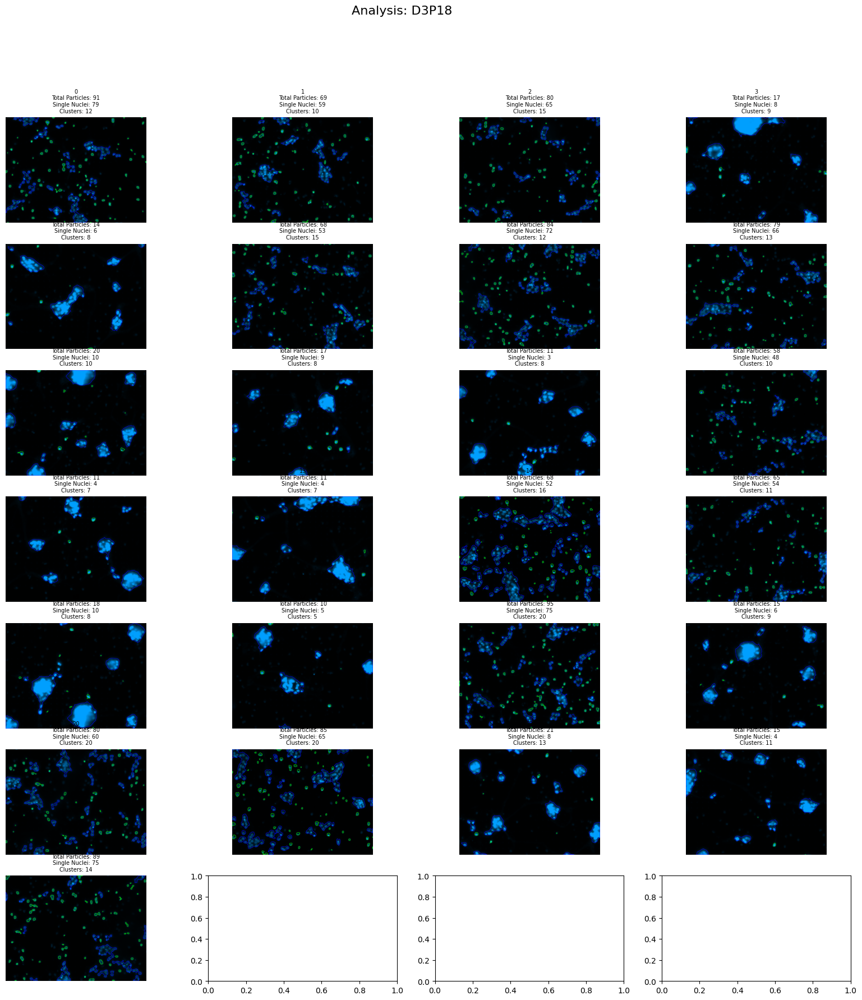

...

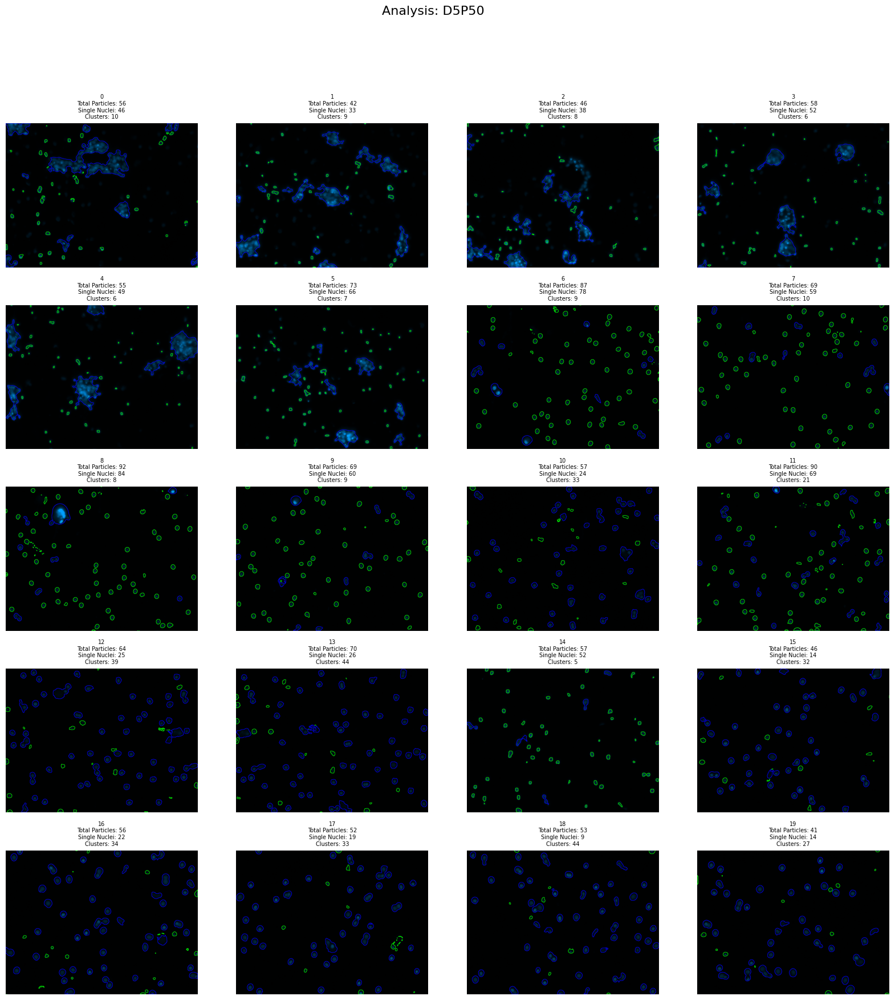

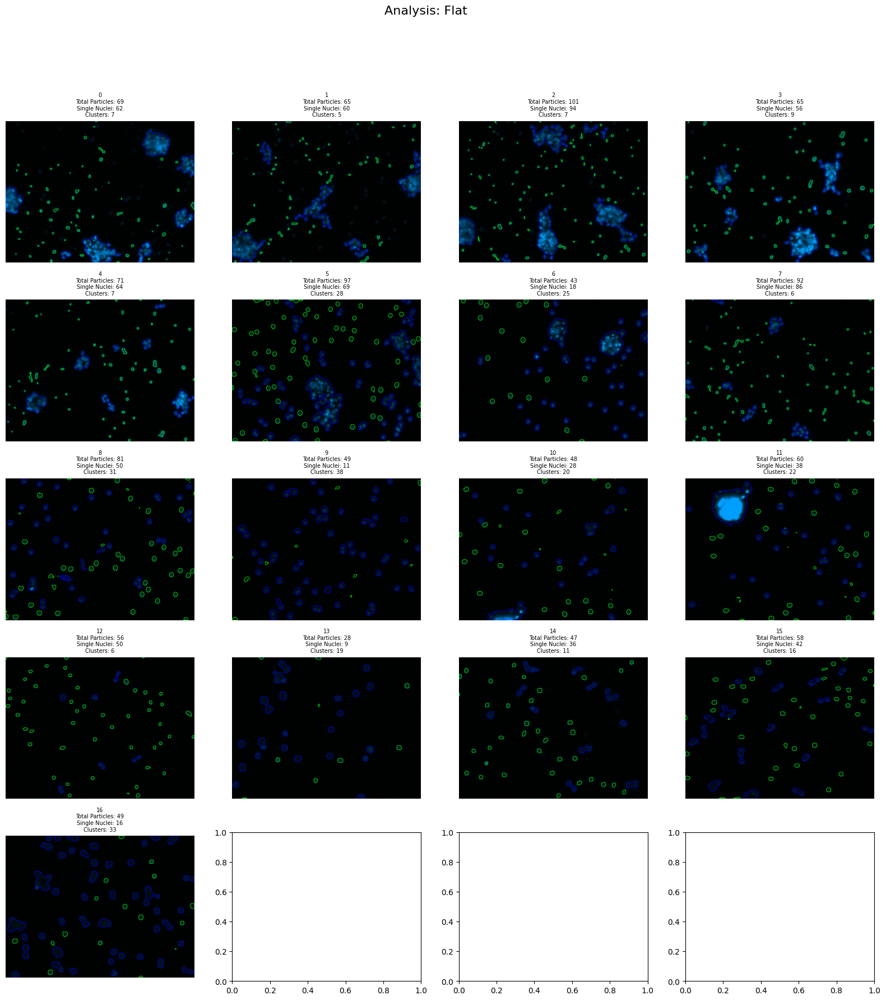

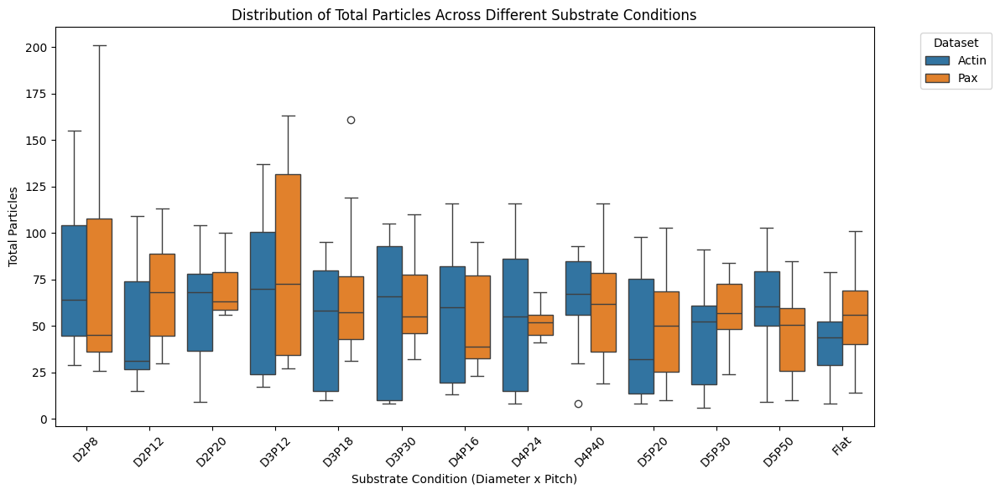

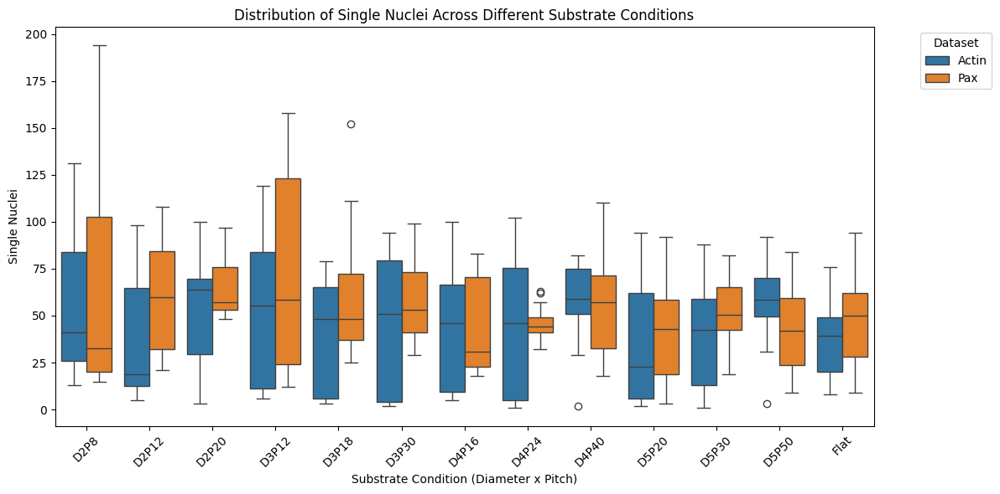

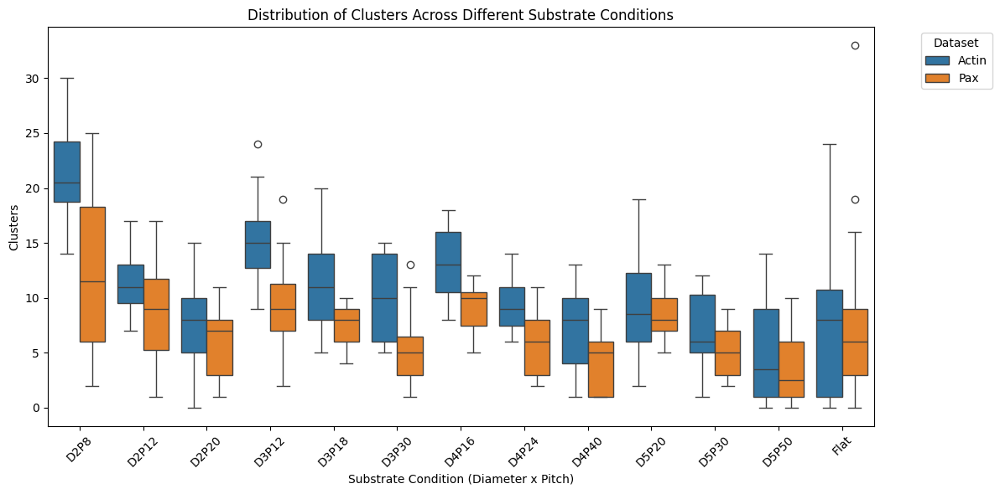

In [9]:
# Constants
SCALE_FACTOR = 1 / 3  # 3 pixels per micrometer

# Configurable Parameters
SOLIDITY_THRESHOLD = 0.4
EPS = 40
MIN_SAMPLES = 4
KERNEL_SIZE = 3
MIN_NUCLEUS_AREA = 3000
OFFSET = 20
THRESHOLD = 5
# Plotting Parameters
FIGURE_SIZE = (12, 6)
ROTATION_ANGLE = 45


def main():
    parent_folders = [
         '/content/drive/MyDrive/MAIA/3.Semester/Germany Master Thesis/Neuroimaging project/Nucleus_Analysis/images/Actin',
        '/content/drive/MyDrive/MAIA/3.Semester/Germany Master Thesis/Neuroimaging project/Nucleus_Analysis/images/Pax',
    ]
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (KERNEL_SIZE, KERNEL_SIZE))
    all_data = []

    for parent_folder in parent_folders:
        subfolders = [f for f in os.listdir(parent_folder) if os.path.isdir(os.path.join(parent_folder, f))]
        for subfolder in subfolders:
            folder_path = os.path.join(parent_folder, subfolder)
            diameter, pitch = parse_folder_name(subfolder)
            condition = 'Flat' if (diameter, pitch) == (0,0) else f"D{diameter}P{pitch}"
            folder_data = analyze_folder(folder_path, kernel, MIN_NUCLEUS_AREA, SCALE_FACTOR, diameter, pitch, SOLIDITY_THRESHOLD, EPS, MIN_SAMPLES, OFFSET, THRESHOLD)

            for data in folder_data:
                data['Condition'] = condition
                data['Dataset'] = os.path.basename(parent_folder)  # Distinguish between different datasets

            all_data.extend(folder_data)

    data_df = pd.DataFrame(all_data)

    sorted_conditions = sorted(data_df['Condition'].unique(), key=numerical_sort)
    data_df['Condition'] = pd.Categorical(data_df['Condition'], categories=sorted_conditions, ordered=True)

    # Plotting
    measurements = ['Total Particles', 'Single Nuclei', 'Clusters']
    for measurement in measurements:
        plt.figure(figsize=(12, 6))
        sns.boxplot(data=data_df, x='Condition', y=measurement, hue='Dataset')  # Use hue to distinguish datasets
        plt.title(f'Distribution of {measurement} Across Different Substrate Conditions')
        plt.xlabel('Substrate Condition (Diameter x Pitch)')
        plt.ylabel(measurement)
        plt.xticks(rotation=45)
        plt.legend(title='Dataset', bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

if __name__ == "__main__":
    main()